<a href="https://colab.research.google.com/github/mdparvex/polyp-segmentation/blob/main/X_Unet_with_transformer_enched_self_attention_decoder_polyp_segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf
tf.test.gpu_device_name()

'/device:GPU:0'

In [ ]:
#libraries
import os
import random

import numpy as np
import cv2
from glob import glob
from scipy.ndimage import rotate
from tqdm import tqdm
from sklearn.model_selection import train_test_split

In [ ]:
#Process Image Part -1
# Read and Save Image
def read_image(imagefile, grayscale=False):
    if grayscale == True:
        image = cv2.imread(imagefile)
        #image = np.expand_dims(image, -1)
    else:
        image = cv2.imread(imagefile)
    return image

def save_image(image, mask, path, binary=True):
    image = np.array(image)
    if binary == True:
        mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)
    cv2.imwrite(path[0], image)
    cv2.imwrite(path[1], mask)

In [ ]:
#Process Image Part -2
# Data Augmentation
def concat_images(images, rows, cols):
    _, h, w, _ = images.shape
    images = images.reshape((rows, cols, h, w, 3))
    images = images.transpose(0, 2, 1, 3, 4)
    images = images.reshape((rows * h, cols * w, 3))
    return images

def check_size(size):
    if type(size) == int:
        size = (size, size)
    if type(size) != tuple:
        raise TypeError('size is int or tuple')
    return size

def subtract(image):
    image = image / 255
    return image

def resize(image, size):
    size = check_size(size)
    image = cv2.resize(image, size)
    return image

def center_crop(image, mask, crop_size, size):
    h, w, _ = image.shape
    crop_size = check_size(crop_size)
    top = (h - crop_size[0]) // 2
    left = (w - crop_size[1]) // 2
    bottom = top + crop_size[0]
    right = left + crop_size[1]

    image = image[top:bottom, left:right, :]
    mask = mask[top:bottom, left:right, :]

    image = resize(image, size)
    mask = resize(mask, size)

    return image, mask

def random_crop(image, mask, crop_size, size):
    crop_size = check_size(crop_size)
    h, w, _ = image.shape
    top = np.random.randint(0, h - crop_size[0])
    left = np.random.randint(0, w - crop_size[1])
    bottom = top + crop_size[0]
    right = left + crop_size[1]

    image = image[top:bottom, left:right, :]
    mask = mask[top:bottom, left:right, :]

    image = resize(image, size)
    mask = resize(mask, size)

    return image, mask

def horizontal_flip(image, mask, size):
    image = image[:, ::-1, :]
    mask = mask[:, ::-1, :]

    image = resize(image, size)
    mask = resize(mask, size)

    return image, mask

def vertical_flip(image, mask, size):
    image = image[::-1, :, :]
    mask = mask[::-1, :, :]

    image = resize(image, size)
    mask = resize(mask, size)

    return image, mask

def scale_augmentation(image, mask, scale_range, crop_size, size):
    scale_size = np.random.randint(*scale_range)
    image = cv2.resize(image, (scale_size, scale_size))
    mask = cv2.resize(mask, (scale_size, scale_size))
    image, mask = random_crop(image, mask, crop_size, size)
    return image, mask

def random_rotation(image, mask, size, angle_range=(0, 90)):
    h1, w1, _ = image.shape
    h2, w2, _ = mask.shape

    angle = np.random.randint(*angle_range)
    image = rotate(image, angle)
    image = resize(image, (h1, w1))

    mask = rotate(mask, angle)
    mask = resize(mask, (h2, w2))

    image = resize(image, size)
    mask = resize(mask, size)

    return image, mask

def cutout(image_origin, mask_origin, mask_size, mask_value='mean'):
    image = np.copy(image_origin)
    mask = np.copy(mask_origin)

    if mask_value == 'mean':
        mask_value = image.mean()
    elif mask_value == 'random':
        mask_value = np.random.randint(0, 256)

    h, w, _ = image.shape
    top = np.random.randint(0 - mask_size // 2, h - mask_size)
    left = np.random.randint(0 - mask_size // 2, w - mask_size)
    bottom = top + mask_size
    right = left + mask_size
    if top < 0:
        top = 0
    if left < 0:
        left = 0

    image[top:bottom, left:right, :].fill(mask_value)
    mask[top:bottom, left:right, :].fill(0)

    image = resize(image, size)
    mask = resize(mask, size)

    return image, mask

def brightness_augment(img, mask, factor=0.5):
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV) #convert to hsv
    hsv = np.array(hsv, dtype=np.float64)
    hsv[:, :, 2] = hsv[:, :, 2] * (factor + np.random.uniform()) #scale channel V uniformly
    hsv[:, :, 2][hsv[:, :, 2] > 255] = 255 #reset out of range values
    rgb = cv2.cvtColor(np.array(hsv, dtype=np.uint8), cv2.COLOR_HSV2RGB)

    image = resize(rgb, size)
    mask = resize(mask, size)

    return image, mask

def rgb_to_grayscale(img, mask):
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    img = [img, img, img]
    img = np.transpose(img, (1, 2, 0))

    image = resize(img, size)
    mask = resize(mask, size)
    return image, mask

In [ ]:
def create_dir(name):
    try:
        os.mkdir(name)
    except:
        pass

In [ ]:
#Process Image Part - 3
"""
train, val, test set creation,
and save those images in a folder named 'new_data'
"""
if __name__ == '__main__':
    ### Image Augmentation
    size = (256, 256)
    crop_size = (300, 300)

    path = "/kaggle/input/polyp-dataset-for-semantic-segmentation"
    dataset_name = "Kvasir-SEG"
    full_path = os.path.join(path, dataset_name)

    new_path = "./"
    create_dir(new_path)
    new_full_path = os.path.join(new_path, dataset_name)

    train_path = os.path.join(new_full_path, "train")
    valid_path = os.path.join(new_full_path, "valid")
    test_path = os.path.join(new_full_path, "test")

    if not os.path.exists(new_full_path):
        os.mkdir(new_full_path)
        for path in [train_path, valid_path, test_path]:
            os.mkdir(path)
            os.mkdir(os.path.join(path, "images"))
            os.mkdir(os.path.join(path, "masks"))

    images = glob(os.path.join(full_path, "images/", "*"))
    masks = glob(os.path.join(full_path, "masks/", "*"))

    images.sort()
    masks.sort()

    len_ids = len(images)
    train_size = int((80/100)*len_ids)
    valid_size = int((10/100)*len_ids)		## Here 10 is the percent of images used for validation
    test_size = int((10/100)*len_ids)		## Here 10 is the percent of images used for testing

    train_images, test_images = train_test_split(images, test_size=test_size, random_state=42)
    train_masks, test_masks = train_test_split(masks, test_size=test_size, random_state=42)

    train_images, valid_images = train_test_split(train_images, test_size=test_size, random_state=42)
    train_masks, valid_masks = train_test_split(train_masks, test_size=test_size, random_state=42)

    print("Total Size: ", len_ids)
    print("Training Size: ", train_size)
    print("Validation Size: ", valid_size)
    print("Testing Size: ", test_size)

    ## testing images and masks
    for idx, p in tqdm(enumerate(test_images), total=len(test_images)):
        ## Path
        name = p.split("/")[-1].split(".")[0]
        image_path = test_images[idx]
        mask_path = test_masks[idx]

        if os.path.exists(image_path) and os.path.exists(mask_path):
            image = read_image(image_path)
            mask = read_image(mask_path, grayscale=True)

            new_image_path = os.path.join(new_full_path, "test", "images/")
            new_mask_path = os.path.join(new_full_path, "test", "masks/")

            image = resize(image, size)
            mask = resize(mask, size)

            img_path = new_image_path + str(name) + ".jpg"
            mask_path = new_mask_path + str(name) + ".jpg"
            tmp_path = [img_path, mask_path]
            save_image(image, mask, tmp_path)

    ## Validation images and masks
    for idx, p in tqdm(enumerate(valid_images), total=len(valid_images)):
        ## Path
        name = p.split("/")[-1].split(".")[0]
        image_path = valid_images[idx]
        mask_path = valid_masks[idx]

        if os.path.exists(image_path) and os.path.exists(mask_path):
            image = read_image(image_path)
            mask = read_image(mask_path, grayscale=True)

            ## Augment
            image1, mask1 = center_crop(image, mask, crop_size, size)
            image2, mask2 = random_crop(image, mask, crop_size, size)
            image3, mask3 = horizontal_flip(image, mask, size)
            image4, mask4 = vertical_flip(image, mask, size)
            image5, mask5 = scale_augmentation(image, mask, (512, 768), crop_size, size)
            image6, mask6 = random_rotation(image, mask, size)
            image7, mask7 = cutout(image, mask, 224)
            ## Extra Cropping
            image8, mask8 = random_crop(image, mask, crop_size, size)
            ## Extra Scale Augmentation
            image10, mask10 = scale_augmentation(image, mask, (540, 820), crop_size, size)
            image11, mask11 = scale_augmentation(image, mask, (720, 1024), crop_size, size)
            ## Extra Rotation
            image12, mask12 = random_rotation(image, mask, size)
            image13, mask13 = random_rotation(image, mask, size)
            ## Brightness
            image14, mask14 = brightness_augment(image, mask, factor=0.3)
            image15, mask15 = brightness_augment(image, mask, factor=0.6)
            image16, mask16 = brightness_augment(image, mask, factor=0.9)
            ## More Rotation
            #image17, mask17 = random_rotation(image, mask, size)
            #image18, mask18 = random_rotation(image, mask, size)
            ## More Random Crop
            image19, mask19 = random_crop(image, mask, crop_size, size)
            #image20, mask20 = random_crop(image, mask, crop_size, size)
            ## More Cutout
            image21, mask21 = cutout(image, mask, 224)
            image22, mask22 = cutout(image, mask, 256)
            image23, mask23 = rgb_to_grayscale(image, mask)
            image24, mask24 = rgb_to_grayscale(image5, mask5)
            image25, mask25 = rgb_to_grayscale(image15, mask15)

            new_image_path = os.path.join(new_full_path, "valid", "images/")
            new_mask_path = os.path.join(new_full_path, "valid", "masks/")

            ## All images and masks
            all_images = [image, image1, image2, image3, image4, image5, image6,image7, image8,
                          image10, image11, image12, image13, image14, image15, image16, image19,
                          image21, image22, image23, image24, image25]
            all_masks  = [mask, mask1, mask2, mask3, mask4, mask5, mask6, mask7, mask8,
                          mask10 ,mask11, mask12, mask13, mask14, mask15, mask16, mask19,
                          mask21, mask22, mask23, mask24, mask25]

            image = resize(image, size)
            mask = resize(mask, size)

            for j in range(len(all_images)):
                img_path = new_image_path + str(name) + "_" + str(j) + ".jpg"
                msk_path = new_mask_path + str(name) + "_" + str(j) + ".jpg"
                img = all_images[j]
                msk = all_masks[j]
                path = [img_path, msk_path]
                #tmp_path = [img_path, mask_path]
                #save_image(image, mask, tmp_path)
                save_image(img, msk, path)

    ## Training images and masks
    for idx, p in tqdm(enumerate(train_images), total=len(train_images)):
        ## Path
        name = p.split("/")[-1].split(".")[0]
        image_path = train_images[idx]
        mask_path = train_masks[idx]

        if os.path.exists(image_path) and os.path.exists(image_path):
            image = read_image(image_path)
            mask = read_image(mask_path, grayscale=True)

            ## Augment
            image1, mask1 = center_crop(image, mask, crop_size, size)
            image2, mask2 = random_crop(image, mask, crop_size, size)
            image3, mask3 = horizontal_flip(image, mask, size)
            image4, mask4 = vertical_flip(image, mask, size)
            image5, mask5 = scale_augmentation(image, mask, (512, 768), crop_size, size)
            image6, mask6 = random_rotation(image, mask, size)
            image7, mask7 = cutout(image, mask, 224)
            ## Extra Cropping
            image8, mask8 = random_crop(image, mask, crop_size, size)
            ## Extra Scale Augmentation
            image10, mask10 = scale_augmentation(image, mask, (540, 820), crop_size, size)
            image11, mask11 = scale_augmentation(image, mask, (720, 1024), crop_size, size)
            ## Extra Rotation
            image12, mask12 = random_rotation(image, mask, size)
            image13, mask13 = random_rotation(image, mask, size)
            ## Brightness
            image14, mask14 = brightness_augment(image, mask, factor=0.3)
            image15, mask15 = brightness_augment(image, mask, factor=0.6)
            image16, mask16 = brightness_augment(image, mask, factor=0.9)
            ## More Rotation
            #image17, mask17 = random_rotation(image, mask, size)
            #image18, mask18 = random_rotation(image, mask, size)
            ## More Random Crop
            image19, mask19 = random_crop(image, mask, crop_size, size)
            #image20, mask20 = random_crop(image, mask, crop_size, size)
            ## More Cutout
            image21, mask21 = cutout(image, mask, 224)
            image22, mask22 = cutout(image, mask, 256)
            ## Grayscale
            image23, mask23 = rgb_to_grayscale(image, mask)
            image24, mask24 = rgb_to_grayscale(image5, mask5)
            image25, mask25 = rgb_to_grayscale(image15, mask15)
            image26, mask26 = rgb_to_grayscale(image3, mask3)
            image27, mask27 = rgb_to_grayscale(image4, mask4)
            image28, mask28 = rgb_to_grayscale(image5, mask5)
            image29, mask29 = rgb_to_grayscale(image15, mask15)
            image30, mask30 = rgb_to_grayscale(image16, mask16)

            ## Original image and mask
            image = resize(image, size)
            mask = resize(mask, size)

            ## All images and masks
            all_images = [image, image1, image2, image3, image4, image5, image6,image7, image8,
                          image10, image11, image12, image13, image14, image15, image16, image19,
                          image21, image22, image23, image24, image25, image26, image27, image28, image29, image30]
            all_masks  = [mask, mask1, mask2, mask3, mask4, mask5, mask6, mask7, mask8,
                          mask10 ,mask11, mask12, mask13, mask14, mask15, mask16, mask19,
                          mask21, mask22, mask23, mask24, mask25, mask26, mask27, mask28, mask29, mask30]

            ## Save the images and masks
            new_image_path = os.path.join(new_full_path, "train", "images/")
            new_mask_path = os.path.join(new_full_path, "train", "masks/")

            for j in range(len(all_images)):
                img_path = new_image_path + str(name) + "_" + str(j) + ".jpg"
                msk_path = new_mask_path + str(name) + "_" + str(j) + ".jpg"

                img = all_images[j]
                msk = all_masks[j]
                path = [img_path, msk_path]

                save_image(img, msk, path)

Total Size:  1000
Training Size:  800
Validation Size:  100
Testing Size:  100


100%|██████████| 800/800 [15:35<00:00,  1.17s/it]


IndexError: index 75 is out of bounds for axis 0 with size 75

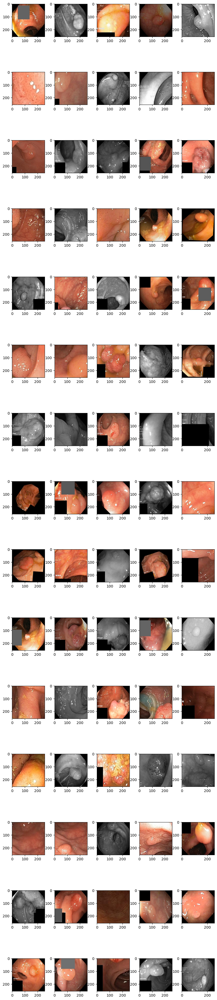

In [ ]:
# Put all images in the folder into a list (works)
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
import glob
# Put all images in the folder into a list (works)
images = []
for f in glob.iglob("./Kvasir-SEG/train/images/*"):
    images.append(np.asarray(Image.open(f)))

# plot the images (works)
images = np.array(images)
fig, axs = plt.subplots(15, 5, figsize=(10, 50))
fig.subplots_adjust(hspace = .3, wspace=.3)
axs = axs.ravel()

# This is for displaying the names (works)
for filename in os.listdir('./Kvasir-SEG/train/images/'):
  RatName = filename[:-4]

i = 0
for filename in os.listdir('./Kvasir-SEG/train/images/'):
  RatName = filename[:-4]
  axs[i].imshow(images[i-1])
  #axs[i].set_title(RatName)
  i += 1

IndexError: index 75 is out of bounds for axis 0 with size 75

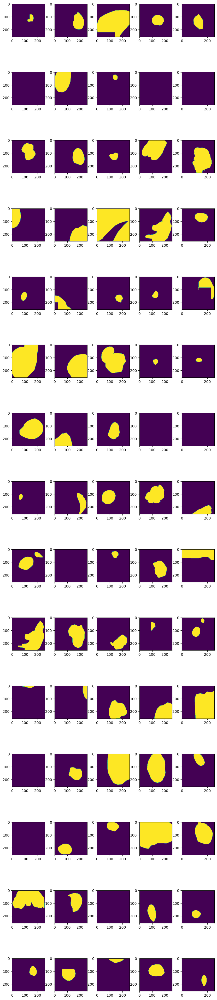

In [ ]:
# Put all images in the folder into a list (works)
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
import glob
# Put all images in the folder into a list (works)
images = []
for f in glob.iglob("./Kvasir-SEG/train/masks/*"):
    images.append(np.asarray(Image.open(f)))

# plot the images (works)
images = np.array(images)
fig, axs = plt.subplots(15, 5, figsize=(10, 50))
fig.subplots_adjust(hspace = .3, wspace=.3)
axs = axs.ravel()

# This is for displaying the names (works)
for filename in os.listdir('./Kvasir-SEG/train/masks/'):
  RatName = filename[:-4]

i = 0
for filename in os.listdir('./Kvasir-SEG/train/masks/'):
  RatName = filename[:-4]
  axs[i].imshow(images[i-1])
  #axs[i].set_title(RatName)
  i += 1

In [ ]:
"""
Data Generator
"""
import os
import numpy as np
import cv2
from tensorflow.keras.utils import Sequence

def parse_image(img_path, image_size):
    image_rgb = cv2.imread(img_path, 1)
    h, w, _ = image_rgb.shape
    if (h == image_size) and (w == image_size):
        pass
    else:
        image_rgb = cv2.resize(image_rgb, (image_size, image_size))
    image_rgb = image_rgb/255.0
    return image_rgb

def parse_mask(mask_path, image_size):
    mask = cv2.imread(mask_path, -1)
    h, w = mask.shape
    if (h == image_size) and (w == image_size):
        pass
    else:
        mask = cv2.resize(mask, (image_size, image_size))
    mask = np.expand_dims(mask, -1)
    mask = mask/255.0

    return mask

class DataGen(Sequence):
    def __init__(self, image_size, images_path, masks_path, batch_size=8, **kwargs):
        super().__init__(**kwargs)  # Properly initialize the parent class
        self.image_size = image_size
        self.images_path = images_path
        self.masks_path = masks_path
        self.batch_size = batch_size
        self.on_epoch_end()

    def __getitem__(self, index):
        if(index+1)*self.batch_size > len(self.images_path):
            self.batch_size = len(self.images_path) - index*self.batch_size

        images_path = self.images_path[index*self.batch_size : (index+1)*self.batch_size]
        masks_path = self.masks_path[index*self.batch_size : (index+1)*self.batch_size]

        images_batch = []
        masks_batch = []

        for i in range(len(images_path)):
            ## Read image and mask
            image = parse_image(images_path[i], self.image_size)
            mask = parse_mask(masks_path[i], self.image_size)

            images_batch.append(image)
            masks_batch.append(mask)

        return np.array(images_batch), np.array(masks_batch)

    def on_epoch_end(self):
        pass

    def __len__(self):
        return int(np.ceil(len(self.images_path)/float(self.batch_size)))

In [ ]:
from tensorflow.keras.layers import Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, Input, ZeroPadding2D, Multiply, GlobalAveragePooling2D, Reshape, Dense, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.applications import Xception

def conv_block(input, num_filters):
    x = Conv2D(num_filters, 3, padding="same")(input)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)
    #x = Dropout(0.3)(x)

    x = Conv2D(num_filters, 3, padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    return x

def attention_block(input, skip_features, num_filters):
    """ Self-attention mechanism """
    g1 = Conv2D(num_filters, 1, padding="same")(input)
    g1 = BatchNormalization()(g1)

    x1 = Conv2D(num_filters, 1, padding="same")(skip_features)
    x1 = BatchNormalization()(x1)

    combined = Activation("relu")(g1 + x1)
    attention = Conv2D(1, 1, padding="same", activation="sigmoid")(combined)
    attention = Multiply()([skip_features, attention])

    return attention

def decoder_block(input, skip_features, num_filters):
    """ Decoder block with self-attention """
    x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(input)
    attention = attention_block(x, skip_features, num_filters)
    x = Concatenate()([x, attention])
    x = conv_block(x, num_filters)
    return x

def se_block(input_tensor, reduction_ratio=16):
    """ Squeeze-and-Excitation block """
    num_filters = input_tensor.shape[-1]
    se = GlobalAveragePooling2D()(input_tensor)
    se = Reshape((1, 1, num_filters))(se)
    se = Dense(num_filters // reduction_ratio, activation="relu")(se)
    se = Dense(num_filters, activation="sigmoid")(se)
    return Multiply()([input_tensor, se])

def build_xception_unet(input_shape):
    """ Input """
    inputs = Input(shape=(input_shape, input_shape, 3), name="input_image")
    xception = Xception(include_top=False, weights="imagenet", input_tensor=inputs)

    s1 = xception.get_layer("input_image").output         ## (256 x 256)
    s2 = xception.get_layer("block1_conv1_act").output
    s2 = ZeroPadding2D(( (1, 0), (1, 0) ))(s2)           ## (128 x 128)
    s3 = xception.get_layer("block3_sepconv2_bn").output
    s3 = ZeroPadding2D(( (1, 0), (1, 0) ))(s3)           ## (56 x 56)
    s4 = xception.get_layer("block4_sepconv2_bn").output ## (28 x 28)

    """ Bridge with SE block """
    b1 = xception.get_layer("block13_sepconv2_bn").output ## (14 x 14)
    b1 = se_block(b1)

    """ Decoder with self-attention """
    d1 = decoder_block(b1, s4, 512)                     ## (28 x 28)
    d2 = decoder_block(d1, s3, 256)                     ## (56 x 112)
    d3 = decoder_block(d2, s2, 128)                     ## (128 x 128)
    d4 = decoder_block(d3, s1, 64)                      ## (256 x 256)

    """ Output """
    outputs = Conv2D(1, 1, padding="same", activation="sigmoid")(d4)
    model = Model(inputs, outputs, name="Xception_U-Net_with_Attention")

    return model


In [ ]:
if __name__ == "__main__":
    input_shape = (256)
    model = build_xception_unet(input_shape)
    model.summary()

83683744/83683744 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "Xception_U-Net_with_Attention"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_image (InputLayer)  │ (None, 256, 256, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv1 (Conv2D)     │ (None, 127, 127, 32)   │            864 │ input_image[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv1_bn           │ (None, 127, 127, 32)   │            128 │ block1_conv1[0][0]     │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv1_act          │ (None, 127, 127, 32)   │              0 │ block1_conv1_bn[0][0]  │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv2 (Conv2D)     │ (None, 125, 125, 64)   │         18,432 │ block1_conv1_act[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv2_bn           │ (None, 125, 125, 64)   │            256 │ block1_conv2[0][0]     │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv2_act          │ (None, 125, 125, 64)   │              0 │ block1_conv2_bn[0][0]  │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_sepconv1           │ (None, 125, 125, 128)  │          8,768 │ block1_conv2_act[0][0] │
│ (SeparableConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_sepconv1_bn        │ (None, 125, 125, 128)  │            512 │ block2_sepconv1[0][0]  │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_sepconv2_act       │ (None, 125, 125, 128)  │              0 │ block2_sepconv1_bn[0]… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_sepconv2           │ (None, 125, 125, 128)  │         17,536 │ block2_sepconv2_act[0… │
│ (SeparableConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_sepconv2_bn        │ (None, 125, 125, 128)  │            512 │ block2_sepconv2[0][0]  │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, 63, 63, 128)    │          8,192 │ block1_conv2_act[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_pool               │ (None, 63, 63, 128)    │              0 │ block2_sepconv2_bn[0]… │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization  

 Total params: 29,335,213 (111.90 MB)

 Trainable params: 29,282,221 (111.70 MB)

 Non-trainable params: 52,992 (207.00 KB)

In [ ]:
"""
Model Matrics
"""
import os
import numpy as np
import cv2
import tensorflow as tf
from tensorflow.keras import backend as K

smooth = 1.
def dice_coef(y_true, y_pred):
    y_true_f = tf.keras.layers.Flatten()(y_true)
    y_pred_f = tf.keras.layers.Flatten()(y_pred)
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + smooth)


def dice_loss(y_true, y_pred):
    return 1.0 - dice_coef(y_true, y_pred)

In [ ]:
import os
import numpy as np
import cv2
from glob import glob
import tensorflow as tf
train_path = "./Kvasir-SEG/train/"
valid_path = "./Kvasir-SEG/valid/"

## Training
train_image_paths = glob(os.path.join(train_path, "images", "*"))
train_mask_paths = glob(os.path.join(train_path, "masks", "*"))
train_image_paths.sort()
train_mask_paths.sort()

# train_image_paths = train_image_paths[:2000]
# train_mask_paths = train_mask_paths[:2000]

## Validation
valid_image_paths = glob(os.path.join(valid_path, "images", "*"))
valid_mask_paths = glob(os.path.join(valid_path, "masks", "*"))
valid_image_paths.sort()
valid_mask_paths.sort()
print(len(train_image_paths))
print(len(valid_mask_paths))

21600
2200


In [ ]:
import os
import numpy as np
import cv2
from glob import glob
import tensorflow as tf
from tensorflow.keras.metrics import Precision, Recall, MeanIoU
from tensorflow.keras.optimizers import Adam, Nadam, SGD
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, CSVLogger

# from data_generator import DataGen
# from m_resunet import ResUnetPlusPlus
# from metrics import dice_coef, dice_loss

if __name__ == "__main__":
    ## Path
    file_path = "./files/"
    model_path = "./files/xception_unet.keras"

    ## Create files folder
    try:
        os.mkdir("./files")
    except:
        pass

    train_path = "./Kvasir-SEG/train/"
    valid_path = "./Kvasir-SEG/valid/"

    ## Training
    train_image_paths = glob(os.path.join(train_path, "images", "*"))
    train_mask_paths = glob(os.path.join(train_path, "masks", "*"))
    train_image_paths.sort()
    train_mask_paths.sort()

    # train_image_paths = train_image_paths[:2000]
    # train_mask_paths = train_mask_paths[:2000]

    ## Validation
    valid_image_paths = glob(os.path.join(valid_path, "images", "*"))
    valid_mask_paths = glob(os.path.join(valid_path, "masks", "*"))
    valid_image_paths.sort()
    valid_mask_paths.sort()

    ## Parameters
    image_size = 256
    batch_size = 32
    lr = 1e-4
    epochs = 50

    train_steps = int(len(train_image_paths)//(batch_size))-1
    valid_steps = int(len(valid_image_paths)//(batch_size))-1
    print(train_steps)
    print(valid_steps)

    ## Generator
    train_gen = DataGen(image_size, train_image_paths, train_mask_paths, batch_size=batch_size)
    valid_gen = DataGen(image_size, valid_image_paths, valid_mask_paths, batch_size=batch_size)

    ## Unet
    #arch = Unet(input_size=image_size)
    #model = arch.build_model()

    ## Unet2
    #arch = Unet()
    model = build_xception_unet(image_size)

    ## ResUnet
    #arch = ResUnet(input_size=image_size)
    #model = arch.build_model()

    ## ResUnet++
    #arch = ResUnetPlusPlus(input_size=image_size)
    #model = arch.build_model()

    # FCN8
    #arch = FCN8(input_size=image_size)
    # model = arch.build_model()

    optimizer = Nadam(lr)
    metrics = ["acc", Recall(), Precision(), dice_coef, MeanIoU(num_classes=2)]
    model.compile(loss=dice_loss, optimizer=optimizer, metrics=metrics)

    csv_logger = CSVLogger(f"{file_path}xception_unet_{batch_size}.csv", append=False)
    checkpoint = ModelCheckpoint(model_path, verbose=1, save_best_only=True)
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, min_lr=1e-6, verbose=1)
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=False)
    callbacks = [csv_logger, checkpoint, reduce_lr, early_stopping]

    history=model.fit(train_gen,
            validation_data=valid_gen,
            #steps_per_epoch=train_steps,
            #validation_steps=valid_steps,
            epochs=epochs,
            callbacks=callbacks,)


674
67
Epoch 1/50
675/675 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - acc: 0.8424 - dice_coef: 0.6298 - loss: 0.3702 - mean_io_u: 0.3662 - precision: 0.6351 - recall: 0.7710
Epoch 1: val_loss improved from inf to 0.17393, saving model to ./files/xception_unet.keras
675/675 ━━━━━━━━━━━━━━━━━━━━ 1716s 2s/step - acc: 0.8425 - dice_coef: 0.6299 - loss: 0.3701 - mean_io_u: 0.3663 - precision: 0.6352 - recall: 0.7710 - val_acc: 0.9309 - val_dice_coef: 0.8259 - val_loss: 0.1739 - val_mean_io_u: 0.2748 - val_precision: 0.8839 - val_recall: 0.8095 - learning_rate: 1.0000e-04
Epoch 2/50
675/675 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - acc: 0.9390 - dice_coef: 0.8469 - loss: 0.1531 - mean_io_u: 0.4367 - precision: 0.9270 - recall: 0.8106
Epoch 2: val_loss improved from 0.17393 to 0.13482, saving model to ./files/xception_unet.keras
675/675 ━━━━━━━━━━━━━━━━━━━━ 1458s 2s/step - acc: 0.9390 - dice_coef: 0.8470 - loss: 0.1530 - mean_io_u: 0.4367 - precision: 0.9270 - recall: 0.8107 - val_acc: 0.9461 - val_dice_coef: 

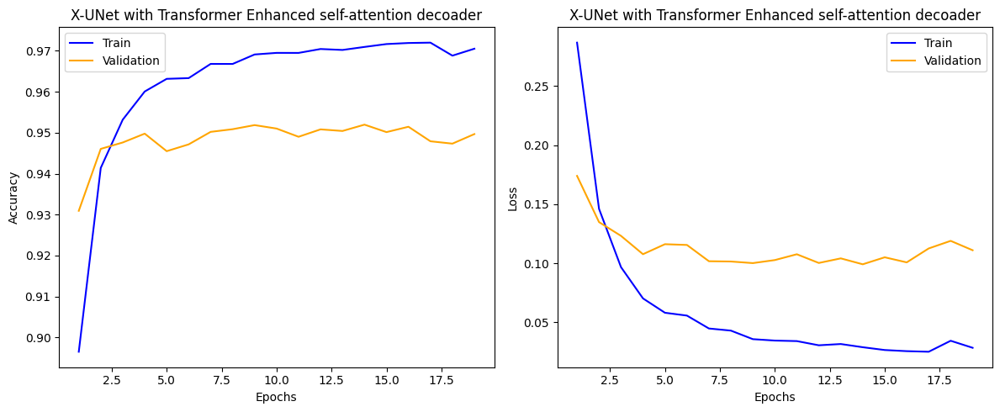

In [ ]:

import matplotlib.pyplot as plt

# Assuming `history` is the object returned by `model.fit()`
# For example: history = model.fit(...)

# Extract training and validation accuracy and loss
train_accuracy = history.history['acc']
val_accuracy = history.history['val_acc']
train_loss = history.history['loss']
val_loss = history.history['val_loss']

# Epochs
epochs = range(1, len(train_accuracy) + 1)

# Plot Model Accuracy
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.plot(epochs, train_accuracy, 'b', label='Train')
plt.plot(epochs, val_accuracy, 'orange', label='Validation')
plt.title('X-UNet with Transformer Enhanced self-attention decoader')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

# Plot Model Loss
plt.subplot(1, 2, 2)
plt.plot(epochs, train_loss, 'b', label='Train')
plt.plot(epochs, val_loss, 'orange', label='Validation')
plt.title('X-UNet with Transformer Enhanced self-attention decoader')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()


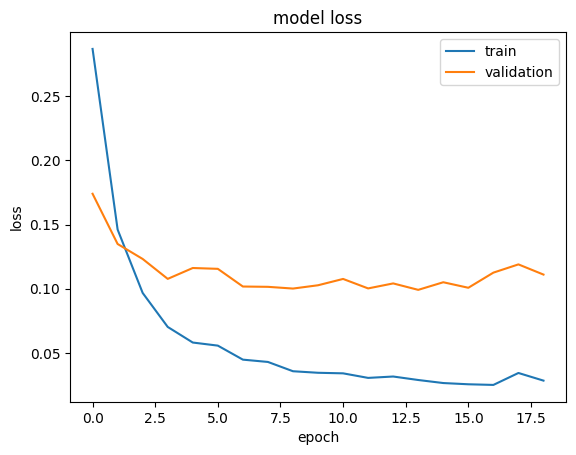

In [ ]:
import matplotlib.pyplot as plt
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper right')
plt.show()

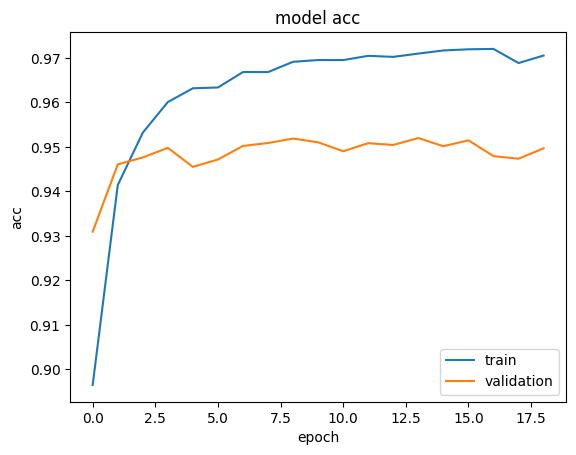

In [ ]:
import matplotlib.pyplot as plt
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'])
plt.title('model acc')
plt.ylabel('acc')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='lower right')
plt.show()

In [ ]:
import os
import numpy as np
import cv2
from glob import glob
from tqdm import tqdm
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.utils import CustomObjectScope

def mask_to_3d(mask):
    mask = np.squeeze(mask)
    mask = [mask, mask, mask]
    mask = np.transpose(mask, (1, 2, 0))
    return mask

if __name__ == "__main__":
    model_path = "./files/xception_unet.keras"
    save_path = "./result"
    test_path = "./Kvasir-SEG/test/"

    image_size = 256
    batch_size = 1

    test_image_paths = glob(os.path.join(test_path, "images", "*"))
    test_mask_paths = glob(os.path.join(test_path, "masks", "*"))
    test_image_paths.sort()
    test_mask_paths.sort()

    ## Create result folder
    try:
        os.mkdir(save_path)
    except:
        pass

    ## Model
    with CustomObjectScope({'dice_loss': dice_loss, 'dice_coef': dice_coef}):
        model = load_model(model_path)

    ## Test
    print("Test Result: ")
    test_steps = len(test_image_paths)//batch_size
    test_gen = DataGen(image_size, test_image_paths, test_mask_paths, batch_size=batch_size)
    model.evaluate(test_gen, steps=test_steps, verbose=1)

    ## Generating the result
    for i, path in tqdm(enumerate(test_image_paths), total=len(test_image_paths)):
        image = parse_image(test_image_paths[i], image_size)
        mask = parse_mask(test_mask_paths[i], image_size)

        predict_mask = model.predict(np.expand_dims(image, axis=0))[0]
        predict_mask = (predict_mask > 0.5) * 255.0

        sep_line = np.ones((image_size, 10, 3)) * 255.0

        mask = mask_to_3d(mask)
        predict_mask = mask_to_3d(predict_mask)

        all_images = [image * 255.0, sep_line, mask * 255.0, sep_line, predict_mask]
        cv2.imwrite(f"{save_path}/{i}.png", np.concatenate(all_images, axis=1))

    print("Test image generation complete")

Test Result: 
100/100 ━━━━━━━━━━━━━━━━━━━━ 12s 28ms/step - acc: 0.9567 - dice_coef: 0.8728 - loss: 0.1272 - mean_io_u: 0.7268 - precision: 0.9220 - recall: 0.8576


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


  1%|          | 1/100 [00:03<05:06,  3.10s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


  2%|▏         | 2/100 [00:03<02:11,  1.34s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


  3%|▎         | 3/100 [00:03<01:15,  1.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


  4%|▍         | 4/100 [00:03<00:49,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


  5%|▌         | 5/100 [00:03<00:34,  2.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


  6%|▌         | 6/100 [00:03<00:26,  3.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


  7%|▋         | 7/100 [00:03<00:20,  4.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


  8%|▊         | 8/100 [00:03<00:16,  5.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


  9%|▉         | 9/100 [00:03<00:14,  6.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 10%|█         | 10/100 [00:04<00:12,  6.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 11%|█         | 11/100 [00:04<00:11,  7.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 12%|█▏        | 12/100 [00:04<00:10,  8.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 13%|█▎        | 13/100 [00:04<00:10,  8.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 14%|█▍        | 14/100 [00:04<00:09,  8.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 15%|█▌        | 15/100 [00:04<00:09,  8.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 16%|█▌        | 16/100 [00:04<00:09,  9.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 17%|█▋        | 17/100 [00:04<00:09,  9.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 18%|█▊        | 18/100 [00:04<00:09,  8.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


 19%|█▉        | 19/100 [00:05<00:09,  8.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


 20%|██        | 20/100 [00:05<00:09,  8.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


 21%|██        | 21/100 [00:05<00:08,  8.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


 22%|██▏       | 22/100 [00:05<00:08,  8.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


 23%|██▎       | 23/100 [00:05<00:08,  8.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


 24%|██▍       | 24/100 [00:05<00:08,  9.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 25%|██▌       | 25/100 [00:05<00:08,  9.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


 26%|██▌       | 26/100 [00:05<00:08,  9.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 27%|██▋       | 27/100 [00:05<00:08,  8.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 28%|██▊       | 28/100 [00:06<00:07,  9.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 29%|██▉       | 29/100 [00:06<00:07,  8.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


 30%|███       | 30/100 [00:06<00:07,  8.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 31%|███       | 31/100 [00:06<00:07,  9.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


 32%|███▏      | 32/100 [00:06<00:07,  9.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 33%|███▎      | 33/100 [00:06<00:07,  9.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 34%|███▍      | 34/100 [00:06<00:07,  9.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 35%|███▌      | 35/100 [00:06<00:06,  9.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


 36%|███▌      | 36/100 [00:06<00:06,  9.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 37%|███▋      | 37/100 [00:06<00:06,  9.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 38%|███▊      | 38/100 [00:07<00:06,  9.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 39%|███▉      | 39/100 [00:07<00:06,  9.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 40%|████      | 40/100 [00:07<00:06,  9.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 41%|████      | 41/100 [00:07<00:06,  9.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


 42%|████▏     | 42/100 [00:07<00:06,  9.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


 43%|████▎     | 43/100 [00:07<00:05,  9.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 44%|████▍     | 44/100 [00:07<00:05,  9.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 45%|████▌     | 45/100 [00:07<00:05,  9.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 46%|████▌     | 46/100 [00:07<00:05,  9.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 47%|████▋     | 47/100 [00:08<00:05,  9.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 48%|████▊     | 48/100 [00:08<00:05,  9.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 49%|████▉     | 49/100 [00:08<00:05,  9.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 50%|█████     | 50/100 [00:08<00:05,  9.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 51%|█████     | 51/100 [00:08<00:05,  9.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


 52%|█████▏    | 52/100 [00:08<00:05,  8.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 53%|█████▎    | 53/100 [00:08<00:05,  9.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 54%|█████▍    | 54/100 [00:08<00:05,  9.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 55%|█████▌    | 55/100 [00:08<00:04,  9.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 56%|█████▌    | 56/100 [00:09<00:04,  9.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 57%|█████▋    | 57/100 [00:09<00:04,  9.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 58%|█████▊    | 58/100 [00:09<00:04,  9.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 59%|█████▉    | 59/100 [00:09<00:04,  9.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 60%|██████    | 60/100 [00:09<00:04,  9.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 61%|██████    | 61/100 [00:09<00:04,  9.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 62%|██████▏   | 62/100 [00:09<00:04,  9.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 63%|██████▎   | 63/100 [00:09<00:03,  9.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 64%|██████▍   | 64/100 [00:09<00:03,  9.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 65%|██████▌   | 65/100 [00:09<00:03,  9.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


 66%|██████▌   | 66/100 [00:10<00:03,  9.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 67%|██████▋   | 67/100 [00:10<00:03,  9.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 68%|██████▊   | 68/100 [00:10<00:03,  9.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


 69%|██████▉   | 69/100 [00:10<00:03,  9.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 70%|███████   | 70/100 [00:10<00:03,  9.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 71%|███████   | 71/100 [00:10<00:03,  9.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 72%|███████▏  | 72/100 [00:10<00:02,  9.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


 73%|███████▎  | 73/100 [00:10<00:02,  9.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 74%|███████▍  | 74/100 [00:10<00:02,  9.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 75%|███████▌  | 75/100 [00:11<00:02,  9.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 76%|███████▌  | 76/100 [00:11<00:02,  9.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


 77%|███████▋  | 77/100 [00:11<00:02,  9.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


 78%|███████▊  | 78/100 [00:11<00:02,  9.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 79%|███████▉  | 79/100 [00:11<00:02,  9.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


 80%|████████  | 80/100 [00:11<00:02,  9.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


 81%|████████  | 81/100 [00:11<00:01,  9.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 82%|████████▏ | 82/100 [00:11<00:01,  9.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


 83%|████████▎ | 83/100 [00:11<00:01,  9.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 84%|████████▍ | 84/100 [00:11<00:01,  9.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 85%|████████▌ | 85/100 [00:12<00:01,  9.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 86%|████████▌ | 86/100 [00:12<00:01,  9.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 87%|████████▋ | 87/100 [00:12<00:01,  9.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 88%|████████▊ | 88/100 [00:12<00:01,  9.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 89%|████████▉ | 89/100 [00:12<00:01,  9.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


 90%|█████████ | 90/100 [00:12<00:01,  9.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 91%|█████████ | 91/100 [00:12<00:00,  9.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 92%|█████████▏| 92/100 [00:12<00:00,  9.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 93%|█████████▎| 93/100 [00:12<00:00,  9.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


 94%|█████████▍| 94/100 [00:13<00:00,  9.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 95%|█████████▌| 95/100 [00:13<00:00,  9.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 96%|█████████▌| 96/100 [00:13<00:00,  9.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 97%|█████████▋| 97/100 [00:13<00:00,  9.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


 98%|█████████▊| 98/100 [00:13<00:00,  9.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


 99%|█████████▉| 99/100 [00:13<00:00,  9.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


100%|██████████| 100/100 [00:13<00:00,  7.33it/s]

Test image generation complete


In [ ]:
!zip -r ./result.zip ./result

  adding: result/ (stored 0%)
  adding: result/15.png (deflated 3%)
  adding: result/26.png (deflated 3%)
  adding: result/76.png (deflated 4%)
  adding: result/75.png (deflated 4%)
  adding: result/23.png (deflated 4%)
  adding: result/3.png (deflated 2%)
  adding: result/2.png (deflated 5%)
  adding: result/82.png (deflated 3%)
  adding: result/34.png (deflated 3%)
  adding: result/70.png (deflated 2%)
  adding: result/14.png (deflated 3%)
  adding: result/78.png (deflated 2%)
  adding: result/84.png (deflated 4%)
  adding: result/0.png (deflated 3%)
  adding: result/31.png (deflated 3%)
  adding: result/37.png (deflated 3%)
  adding: result/16.png (deflated 3%)
  adding: result/22.png (deflated 2%)
  adding: result/18.png (deflated 4%)
  adding: result/68.png (deflated 2%)
  adding: result/36.png (deflated 3%)
  adding: result/28.png (deflated 3%)
  adding: result/54.png (deflated 3%)
  adding: result/92.png (deflated 4%)
  adding: result/20.png (deflated 4%)
  adding: result/49.png

In [ ]:
!zip -r ./files.zip ./files

  adding: files/ (stored 0%)
  adding: files/xception_unet_32.csv (deflated 51%)
  adding: files/xception_unet.keras (deflated 8%)


In [ ]:
# Put all images in the folder into a list (works)
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
import glob
# Put all images in the folder into a list (works)
images = []
for f in glob.iglob("./result/*"):
    images.append(np.asarray(Image.open(f)))

# plot the images (works)
images = np.array(images)
fig, axs = plt.subplots(15, 3, figsize=(150, 150))
fig.subplots_adjust(hspace = .3, wspace=.1)
axs = axs.ravel()

# This is for displaying the names (works)
for filename in os.listdir('./result/'):
  RatName = filename[:-4]

i = 0
for filename in os.listdir('./result/'):
  RatName = filename[:-4]
  axs[i].imshow(images[i])
  #axs[i].set_title(RatName)
  i += 1

IndexError: index 45 is out of bounds for axis 0 with size 45